In [69]:
from matplotlib import font_manager, rc
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import platform
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.metrics import mean_squared_error, mean_absolute_error
import warnings
warnings.filterwarnings('ignore')

In [70]:
tem1721 = pd.read_csv("data/5년기온데이터_전처리.csv").drop(['Unnamed: 0'], axis=1)
tem17210608 = tem1721[tem1721['날짜'].str.contains(
    "2017-06|2017-07|2017-08|2018-06|2018-07|2018-08|2019-06|2019-07|2019-08|2020-06|2020-07|2020-08|2021-06|2021-07|2021-08")].reset_index()
tem17210608.drop('index',axis=1, inplace=True)
tem17210608

,날짜,시간,기온(°C),강수량(mm),풍속(m/s),습도(%)
0,2017-06-01,0:00,21.4,0.0,1.8,74.0
1,2017-06-01,1:00,21.5,0.0,0.9,75.0
2,2017-06-01,2:00,21.3,0.0,1.7,77.0
3,2017-06-01,3:00,20.9,0.0,2.4,81.0
4,2017-06-01,4:00,20.6,0.0,1.1,82.0
...,...,...,...,...,...,...
11035,2021-08-31,19:00,18.1,3.8,3.9,98.0
11036,2021-08-31,20:00,18.1,1.6,4.3,99.0
11037,2021-08-31,21:00,18.1,3.6,3.8,99.0
11038,2021-08-31,22:00,18.3,2.1,3.3,100.0


In [71]:
elec1721=pd.read_csv("data/fintime17_21_df.csv")
elec17210608 = elec1721[elec1721['날짜'].str.contains(
    "2017-06|2017-07|2017-08|2018-06|2018-07|2018-08|2019-06|2019-07|2019-08|2020-06|2020-07|2020-08|2021-06|2021-07|2021-08")].reset_index()
elec17210608.drop('index',axis=1, inplace=True)
elec17210608

,날짜,시간,수요량
0,2017-06-01,00:00,58038
1,2017-06-01,01:00,54763
2,2017-06-01,02:00,52836
3,2017-06-01,03:00,51956
4,2017-06-01,04:00,51299
...,...,...,...
11035,2021-08-31,19:00,74786
11036,2021-08-31,20:00,74099
11037,2021-08-31,21:00,71232
11038,2021-08-31,22:00,68114


In [72]:
tem17210608.drop(['시간'], axis=1, inplace=True)
elec17210608.drop(['날짜'], axis=1, inplace=True)
fin17210608 = pd.concat([tem17210608,elec17210608],axis=1)
fin17210608

,날짜,기온(°C),강수량(mm),풍속(m/s),습도(%),시간,수요량
0,2017-06-01,21.4,0.0,1.8,74.0,00:00,58038
1,2017-06-01,21.5,0.0,0.9,75.0,01:00,54763
2,2017-06-01,21.3,0.0,1.7,77.0,02:00,52836
3,2017-06-01,20.9,0.0,2.4,81.0,03:00,51956
4,2017-06-01,20.6,0.0,1.1,82.0,04:00,51299
...,...,...,...,...,...,...,...
11035,2021-08-31,18.1,3.8,3.9,98.0,19:00,74786
11036,2021-08-31,18.1,1.6,4.3,99.0,20:00,74099
11037,2021-08-31,18.1,3.6,3.8,99.0,21:00,71232
11038,2021-08-31,18.3,2.1,3.3,100.0,22:00,68114


In [73]:
# sns.pairplot(fin17210608)

In [74]:
fin17210608.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11040 entries, 0 to 11039
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   날짜       11040 non-null  object 
 1   기온(°C)   11040 non-null  float64
 2   강수량(mm)  11040 non-null  float64
 3   풍속(m/s)  11040 non-null  float64
 4   습도(%)    11040 non-null  float64
 5   시간       11040 non-null  object 
 6   수요량      11040 non-null  int64  
dtypes: float64(4), int64(1), object(2)
memory usage: 603.9+ KB


In [75]:
# fin17210608['기온(°C)'] = fin17210608['기온(°C)'].round()

In [76]:
# plt.figure(figsize=(20,10))
# # plt.subplot(1,2,1)
# g = sns.boxplot(x="기온(°C)", y="수요량", data=fin17210608, showfliers=False)
# g.set_title('기온과 수요량의 상관관계', size = 20)
# g.set_xticklabels(g.get_xticklabels(),rotation=90)
# plt.show()

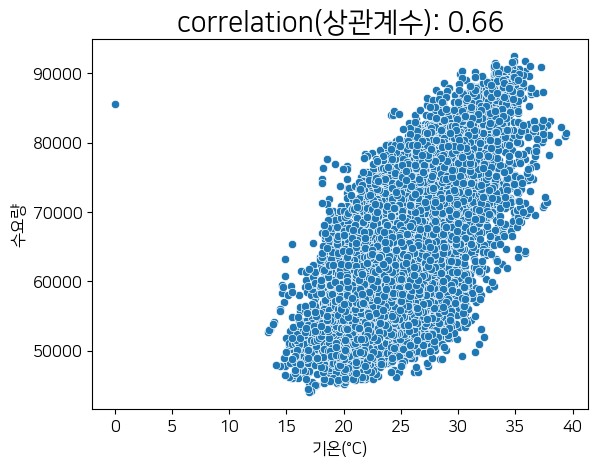

In [77]:
correlation = fin17210608['수요량'].corr(fin17210608['기온(°C)'])
sns.scatterplot(x=fin17210608['기온(°C)'], y=fin17210608['수요량'])
plt.title('correlation(상관계수): '+str(np.round(correlation,2)), fontsize=20)
plt.xlabel("기온(°C)",fontsize=12)
plt.ylabel("수요량",fontsize=12)
plt.show()

In [78]:
# fin17210608['기온(°C)'] = fin17210608[fin17210608['기온(°C)'] > 15]
fin17210608 = fin17210608.loc[fin17210608['기온(°C)'] > 13]
fin17210608

,날짜,기온(°C),강수량(mm),풍속(m/s),습도(%),시간,수요량
0,2017-06-01,21.4,0.0,1.8,74.0,00:00,58038
1,2017-06-01,21.5,0.0,0.9,75.0,01:00,54763
2,2017-06-01,21.3,0.0,1.7,77.0,02:00,52836
3,2017-06-01,20.9,0.0,2.4,81.0,03:00,51956
4,2017-06-01,20.6,0.0,1.1,82.0,04:00,51299
...,...,...,...,...,...,...,...
11035,2021-08-31,18.1,3.8,3.9,98.0,19:00,74786
11036,2021-08-31,18.1,1.6,4.3,99.0,20:00,74099
11037,2021-08-31,18.1,3.6,3.8,99.0,21:00,71232
11038,2021-08-31,18.3,2.1,3.3,100.0,22:00,68114


In [79]:
# plt.figure(figsize=(20,10))
# # plt.subplot(1,2,1)
# g = sns.boxplot(x="기온(°C)", y="수요량", data=fin17210608, showfliers=False)
# g.set_title('기온과 수요량의 상관관계', size = 20)
# g.set_xticklabels(g.get_xticklabels(),rotation=90)
# plt.show()

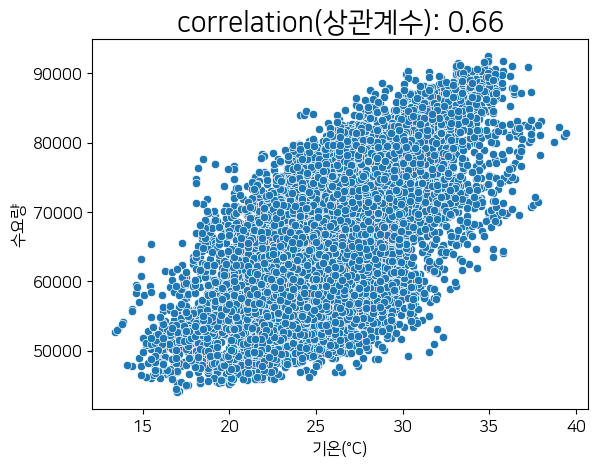

In [80]:
correlation = fin17210608['수요량'].corr(fin17210608['기온(°C)'])
sns.scatterplot(x=fin17210608['기온(°C)'], y=fin17210608['수요량'])
plt.title('correlation(상관계수): '+str(np.round(correlation,2)), fontsize=20)
plt.xlabel("기온(°C)",fontsize=12)
plt.ylabel("수요량",fontsize=12)
plt.show()

In [100]:
y = fin17210608['수요량']
x = fin17210608.drop(columns=['날짜', '시간', '수요량'])

In [101]:
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.3)
x_train, x_test, y_train, y_test

(       기온(°C)  강수량(mm)  풍속(m/s)  습도(%)
 6613     27.3      0.0      2.6   50.0
 6604     19.0      0.0      1.2   80.0
 4808     19.7      0.0      1.9   64.0
 6915     21.7      0.0      0.9   69.0
 10290    32.6      0.0      3.7   58.0
 ...       ...      ...      ...    ...
 10130    28.7      0.0      1.4   64.0
 10686    23.1      0.0      3.0   66.0
 7508     24.9      0.0      2.9   74.0
 9468     27.4      0.0      2.1   57.0
 6941     22.2      0.0      2.0   89.0
 
 [7727 rows x 4 columns],
       기온(°C)  강수량(mm)  풍속(m/s)  습도(%)
 9079    20.6      0.0      3.3   89.0
 5683    30.1      0.0      1.7   62.0
 3731    35.7      0.0      1.6   42.0
 6031    24.5      1.4      2.5   94.0
 7115    28.6      0.0      1.4   49.0
 ...      ...      ...      ...    ...
 3139    20.4      0.5      1.1   94.0
 3711    36.6      0.0      1.5   44.0
 5124    27.0      0.0      2.7   53.0
 9843    26.6      0.0      1.2   85.0
 392     22.6      0.0      1.7   58.0
 
 [3312 rows x 4 column

In [102]:
lr = LinearRegression()
y = fin17210608['수요량']
x = fin17210608.drop(columns=['날짜', '시간', '수요량'])
neg_mse = cross_val_score(lr,x,y,scoring='neg_mean_squared_error', cv=5)
mse = -neg_mse
rmse = np.sqrt(mse)
np.mean(rmse)

7360.186759690504

In [103]:
# from sklearn.preprocessing import StandardScaler, PolynomialFeatures, FunctionTransformer
# from sklearn.linear_model import LinearRegression
# from sklearn.pipeline import make_pipeline

# pipe = make_pipeline(
#     StandardScaler(),
#     PolynomialFeatures(degree=2),
#     FunctionTransformer(np.log1p),
#     LinearRegression()
# )

# pipe.fit(x_train, y_train)
# y_pred = pipe.predict(x_test)
# mse = mean_squared_error(y_test, y_pred)
# rmse = np.sqrt(mse)
# r2 = r2_score(y_test, y_pred)

# print(f'mse:{mse}, rmse:{rmse}, r2:{r2}')

In [104]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

scaler_y = StandardScaler()
# y_train_scaled = scaler_y.fit_transform(y_train.reshape(-1, 1))
# y_test_scaled = scaler_y.transform(y_test.reshape(-1, 1))
y_train_scaled = scaler_y.fit_transform(y_train.values.reshape(-1, 1))
y_test_scaled = scaler_y.transform(y_test.values.reshape(-1, 1))

lr = LinearRegression()
lr.fit(x_train_scaled, y_train_scaled)
y_pred = lr.predict(x_test_scaled)

mse = mean_squared_error(y_test_scaled, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_scaled, y_pred)
print(f'mse:{mse}, rmse:{rmse}, r2:{r2}')

mse:0.529431818813808, rmse:0.7276206558460308, r2:0.4666814158675875


In [105]:
print(lr.score(x_train_scaled, y_train_scaled))
print(lr.score(x_test_scaled, y_test_scaled))

0.4582976601393184
0.4666814158675875


In [106]:
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree=3)
x_train_poly = poly.fit_transform(x_train_scaled)
x_test_poly = poly.transform(x_test_scaled)

lr = LinearRegression()
lr.fit(x_train_poly, y_train_scaled)
y_pred = lr.predict(x_test_poly)

mse = mean_squared_error(y_test_scaled, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_scaled, y_pred)
print(f'mse:{mse}, rmse:{rmse}, r2:{r2}')

mse:0.5042365933330367, rmse:0.7100961859727433, r2:0.4920616093180068


In [107]:
print(lr.score(x_train_poly, y_train_scaled))
print(lr.score(x_test_poly, y_test_scaled))

0.5029748864742254
0.4920616093180068


In [108]:
ridge_reg = Ridge()
ridge_reg.fit(x_train_poly, y_train_scaled)

lasso_reg = Lasso()
lasso_reg.fit(x_test_poly,  y_test_scaled)

Lasso()

In [109]:
def print_best_params(model,params):
    from sklearn.model_selection import GridSearchCV
    grid_model = GridSearchCV(model,
                              param_grid=params,
                              scoring='neg_mean_squared_error',
                              cv=20)
    grid_model.fit(x_train_poly,y_train_scaled)
    rmse = np.sqrt(-grid_model.best_score_)
    print(f'최적 rmse:{rmse}, 최적 alpha :{grid_model.best_params_}')

In [110]:
ridge_params = {'alpha':[10, 50, 100, 200, 300, 500, 1000]}
lasso_params = {'alpha':[0.01, 0.05, 0.1, 1, 10, 100, 300]}
print_best_params(ridge_reg,ridge_params)
print_best_params(lasso_reg,lasso_params)

최적 rmse:0.7158646509690489, 최적 alpha :{'alpha': 300}
최적 rmse:0.7127730007195388, 최적 alpha :{'alpha': 0.01}


In [111]:
ridge = Ridge(alpha=50)
ridge.fit(x_train_poly, y_train_scaled)
print(ridge.score(x_train_poly, y_train_scaled))
print(ridge.score(x_test_poly, y_test_scaled))

0.5024358125711305
0.4947697291219657


In [112]:
lasso = Lasso(alpha=0.01)
lasso.fit(x_train_poly, y_train_scaled)
print(lasso.score(x_train_poly, y_train_scaled))
print(lasso.score(x_test_poly, y_test_scaled))

0.49634316882788043
0.4758415999133744


In [114]:
# plt.figure(figsize=(300, 100))
# plt.plot(y_pred, label='y_pred')
# plt.plot(y_test_scaled, label='y_test_scaled')
# plt.legend()
# plt.show()